In [70]:
#importtamos las librerias
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
import json

In [71]:
#importamos poligonos de comunas 
shapefile='/home/kali/datascience/data//PROVINCIAS_inei_geogpsperu_suyopomalia.shp'

In [72]:
gdf=gpd.read_file(shapefile,encoding='utf-8')

In [73]:
gdf.columns

Index(['OBJECTID', 'NOMBDEP', 'IDPROV', 'CCPP', 'CCDD', 'NOMBPROV', 'FUENTE',
       'POB_PROYEC', 'POBTOTAL', 'POB_EDAD_T', 'POB_EDAD_1', 'POB_EDAD_E',
       'POB_EDAD_2', 'DENSIDAD', 'POBMASCU', 'POBFEMEN', 'POBMASCU_P',
       'POBFEMEN_P', 'R_MASCULIN', 'POBURBANA', 'POBRURAL', 'POBURBANA_',
       'POBRURAL_P', 'EDAD_PROME', 'EDAD_MEDIA', 'POB_0_14', 'POB_0_14_P',
       'POB_15_29', 'POB_15_29_', 'POB_30_59', 'POB_30_59_', 'POB_60_MAS',
       'POB_60_M_1', 'POB_ANALFA', 'POB_ANAL_1', 'HOMBRES_AN', 'HOMBRES__1',
       'MUJERES_AN', 'MUJERES__1', 'MUJERES_ED', 'MUJERES__2', 'TOTAL_MADR',
       'MADRES_SOL', 'MADRES_S_1', 'MUJERES_AD', 'MADRES_ADO', 'MADRES_A_1',
       'AL_MENOS_1', 'AL_MENOS_2', 'SIN_DISCAP', 'SIN_DISC_1', 'ALGUNA_NBI',
       'NBI_PORC', 'VIV_PARTIC', 'VIV_PART_1', 'VIV_PART_2', 'HOGARES',
       'IC_INF', 'IC_SUP', 'UBIC_POBMO', 'TOTAL_DEFU', 'TOTAL_DE_1',
       'TOTAL_DE_2', 'NAC_BAJOPE', 'NAC_BAJO_1', 'MUJERES_NA', 'MUJERES__3',
       'HOMBRES_NA', 'HOMB

In [74]:
df_final=gdf[['NOMBDEP','NOMBPROV','POBTOTAL','geometry']]

<Axes: >

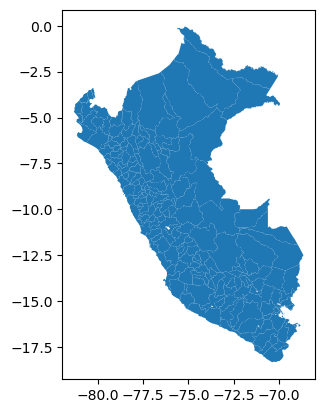

In [75]:
df_final.plot()

In [76]:
#leer data como json
merged_json=json.loads(df_final.to_json())
#convertir objeto a string
json_data=json.dumps(merged_json)

In [77]:
from bokeh.io import output_notebook, show, output_file, save
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource,LinearColorMapper, HoverTool
from bokeh.palettes import brewer   
import plotly as plt

In [78]:
#max color
max_color=df_final['POBTOTAL'].max()
print(max_color)
#cargar la data json_data
gsource=GeoJSONDataSource(geojson=json_data)
#Definimos una paleta de colores
colores =brewer['YlGnBu'][9]
#revertir la paleta para que a mayor numero, mas oscuro 
#inicializar linearcolormapper para que asocie un numero a los colores 
color_mapper=LinearColorMapper(palette=colores,low=0,high=400000)
#agregar hovers 
hover=HoverTool(name='NOMBPROV',tooltips=[('PROVINCIA','@NOMBPROV'),
                                             ('DEPARTAMENTO','@NOMBDEP'),
                                             ('POBLACION','@POBTOTAL')])
#creamos el bojeto figura
fig=figure(title='mapa provincial',
           toolbar_location=None,
           tools=[hover])

9162322.0


In [79]:
fig.xgrid.grid_line_color=None
fig.ygrid.grid_line_color=None
fig.title.text_font_size='20pt'


In [80]:
#ocultamos los ejes 
fig.axis.visible=False


In [81]:
#agregamos provincias
fig.patches('xs','ys',
            source=gsource,
            fill_color={'field':'POBTOTAL','transform':color_mapper},
            line_width=0.2,
            name='provincias')

GlyphRenderer(id='p1383', ...)

In [82]:
output_notebook()
show(fig)

Loading BokehJS ...

Opening in existing browser session.


In [69]:
output_file('mapa.html')
save(fig)

'/home/kali/datascience/code/mapa.html'